In [ ]:
# Help with OOM Error: https://medium.com/@snk.nitin/how-to-solve-cuda-out-of-memory-error-850bb247cfb2

In [1]:
# Standard library imports
import glob as glob
import os
import shutil

# Related third party imports
import datasets
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import torch
import torch.nn.functional as F
import torch.optim as optim
import wandb
from datasets import load_dataset
# from lightning import LightningModule
from scipy.stats import pearsonr
from sklearn.model_selection import train_test_split
from torch.utils.data import DataLoader, Dataset, Subset
from transformers import DataCollatorWithPadding

import json
import os
import subprocess
import transformers
from transformers import PreTrainedModel, AutoModelForCausalLM, PretrainedConfig
import torch.nn as nn

from utils.standard_ds_loader import StandardDatasetLoader

/home/zbates/envs/hyena-dna/lib/python3.8/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


**Make sure you have your data folder!**

In [2]:
PATH_TO_RAW_DATA = './data/'
assert os.path.exists(PATH_TO_RAW_DATA), f'{PATH_TO_RAW_DATA} does not exist. Please download the GDRIVE dataset folder and move into the hyena-dna directory, link on the README'

# Train/Test/Val Dataset Creation

**If you used the StandardDatasetLoader, you will be able to load in that. For the mmseqs dataset specifically, you will be providing a validation dataset, which will stop this function from creating one. This is done because the mmseqs-created validation set uses sequence similarity, something not acheivable in this code.**

**The purpose of using an mmseqs held-out ds is that you can test undersampling or removing entire clusters of seqs**

In [3]:
def create_fine_tuning_datasets(processed_fine_tuning_df, external_processed_val_data_path):
    '''
    Create train, val, and test datasets for fine-tuning
    
    Args:
    processed_fine_tuning_df (pd.DataFrame): The processed fine-tuning dataframe
    external_processed_val_data_path (str): The path to an external processed val dataset (optional). If this is empty,
    you will create your own val dataset, via train/test/split
    
    naming_prefix (str): The prefix to use for the naming of the files. Defaults to "".
    
    Returns:
    train_df_path (str): The path to the train dataset
    test_df_path (str): The path to the test dataset
    train_data_subset_ratio (float): The ratio of the train dataset to use for fine-tuning
    test_data_subset_ratio (float): The ratio of the test dataset to use for fine-tuning
    val_df_path (str): The path to the test dataset
    
    Results:
    The train, val, and test datasets are saved to CSV files in the PATH_TO_FINE_TUNING_DATASPLITS directory
    with the naming_prefix, the val_df_path is returned in addition to the train and test, though the fine-tuning process only uses the train/test. 
    Val is used as a held-out ds (should be unseen)
    '''
    
    RANDOM_STATE = 21
    PATH_TO_FINE_TUNING_DATASPLITS = os.path.join(PATH_TO_RAW_DATA, 'train_val_test_splits')
    os.makedirs(PATH_TO_FINE_TUNING_DATASPLITS, exist_ok=True)
    
    # Define Data Paths
    train_df_path = os.path.join(PATH_TO_FINE_TUNING_DATASPLITS, 'train.csv')
    test_df_path = os.path.join(PATH_TO_FINE_TUNING_DATASPLITS, 'test.csv')
    val_df_path = os.path.join(PATH_TO_FINE_TUNING_DATASPLITS, 'val.csv')

    
    if external_processed_val_data_path != '':
        train_df, test_df = train_test_split(processed_fine_tuning_df, test_size=0.2, random_state=RANDOM_STATE)
        val_df = standard_ds_loader.smart_read_csv(external_processed_val_data_path)
        print(f'It looks like you already have a val dataset at {external_processed_val_data_path}, so we will use that!')
        if len(val_df.columns) > 2:
            val_df = val_df.iloc[:, :2]
            print('Whoops! It loos like your val datasets has more than 2 columns, mostly likely containing the similarity index, so we will take that one out!')

        
    else:
        train_val_df, test_df = train_test_split(processed_fine_tuning_df, test_size=0.2, random_state=RANDOM_STATE)
        train_df, val_df = train_test_split(train_val_df, test_size=0.125, random_state=RANDOM_STATE)
        
    # Save to CSV if needed
    train_df.to_csv(train_df_path, index=False)
    val_df.to_csv(val_df_path, index=False)
    test_df.to_csv(test_df_path, index=False)

    print('Shape of train_df', train_df.shape)
    print('Shape of test_df', test_df.shape)

    if not os.path.exists(PATH_TO_FINE_TUNING_DATASPLITS):
        os.makedirs(PATH_TO_FINE_TUNING_DATASPLITS)

    # path to your training data
    train_data_path = train_df_path 
    # path to your test data
    test_data_path = test_df_path
    
    print(f'The train and test data paths are: {train_data_path} and {test_data_path}. These are what is used for fine-tuning.')

    # the ratio of train data you want to include, where 0.0 is nothing and 1.0 is everything 
    # can be made smaller to make testing faster
    train_data_subset_ratio = 1.0
    # the ratio of test data you want to include, where 0.0 is nothing and 1.0 is everything
    # can be made smaller to make testing faster
    test_data_subset_ratio = 1.0
    
    return train_data_path, test_data_path, train_data_subset_ratio, test_data_subset_ratio, val_df_path

# Select your file to be used for fine-tuning

In [4]:
# Pass in either a path to your own dataset or a string representing the name of a standard dataset
# Three choices for the standard dataset: shalem_15, n50c, shalem_15_n50c

def dataset_creator(dataset):
    
    if dataset == 'shalem_15':
        fine_tuning_dataset = standard_ds_loader.load_shalem_15()
        external_processed_val_data_path = ''
    elif dataset == 'n50c':
        fine_tuning_dataset = standard_ds_loader.load_n50c()
        external_processed_val_data_path = ''
        
    elif dataset == 'shalem_15_n50c':
        external_processed_val_data_path, fine_tuning_dataset = standard_ds_loader.remove_similar_seqs()
    else:
        print('Detected a custom datapath entry, will try loading using smart_read_csv')
        fine_tuning_dataset = standard_ds_loader.smart_read_csv(dataset)
        external_processed_val_data_path = ''
        
    train_data_path, test_data_path, train_data_subset_ratio, test_data_subset_ratio, val_data_path = create_fine_tuning_datasets(fine_tuning_dataset, external_processed_val_data_path=external_processed_val_data_path)
    
    return train_data_path, test_data_path, train_data_subset_ratio, test_data_subset_ratio, val_data_path

In [5]:
standard_ds_loader = StandardDatasetLoader()
train_data_path, test_data_path, train_data_subset_ratio, test_data_subset_ratio, val_data_path = dataset_creator(dataset='shalem_15')

First rows to be processed from ./data/shalem_15.txt:, 0    GGGGACCAGGTGCCGTAAGATTACTTTATATAATGTATAATTCATT...
1    GGGGACCAGGTGCCGTAAGATTACTTTATATAATGTATAATTCATT...
2    GGGGACCAGGTGCCGTAAGATTACTTTATATAATGTATAATTCATT...
3    GGGGACCAGGTGCCGTAAGATTACTTTATATAATGTATAATTCATT...
4    GGGGACCAGGTGCCGTAAGATTACTTTATATAATGTATAATTCATT...
Name: GGGGACCAGGTGCCGTAAGATTACTTTATATAATGTATAATTCATTATGTGATAATGCCAATCGCTTCCGCTAGGTGGCGCTTATATAACTGTCTAGAAATAAAGAGTATCATCTTTCAAAAAAAGACCCTGGCGATCCTAGGGCGATCA, dtype: object
max sequence length: 150
Number of nans in each dataframe:
GGGGACCAGGTGCCGTAAGATTACTTTATATAATGTATAATTCATTATGTGATAATGCCAATCGCTTCCGCTAGGTGGCGCTTATATAACTGTCTAGAAATAAAGAGTATCATCTTTCAAAAAAAGACCCTGGCGATCCTAGGGCGATCA    0
4.9528                                                                                                                                                    0
dtype: int64
Shape before dropping nans: (14171, 2)
Shape after dropping nans: (14171, 2)


First rows after processing: 0    G

# Select Pre-trained model name

In [6]:
# SELECT PRETRAINED MODEL
pretrained_model_name = "hyenadna-tiny-1k-seqlen" 

def is_valid_path(path):
    return os.path.exists(path)
possible_pretrained_names = ['hyenadna-tiny-1k-seqlen', 
                             'hyenadna-small-32k-seqlen', 
                             'hyenadna-medium-160k-seqlen', 
                             'hyenadna-medium-450k-seqlen', 
                             'hyenadna-large-1m-seqlen']

assert pretrained_model_name == None or pretrained_model_name in possible_pretrained_names
assert is_valid_path(train_data_path), f'{train_data_path} does not exist'
assert is_valid_path(test_data_path), f'{test_data_path} does not exist'
for ratio in [train_data_subset_ratio, test_data_subset_ratio]:
    assert ratio >= 0.0 and ratio <= 1.0, f'{ratio} is not a valid ratio'

In [7]:
# these take a little longer so they are in a separate cell
from huggingface import HyenaDNAPreTrainedModel
from standalone_hyenadna import CharacterTokenizer

ModuleNotFoundError: No module named 'standalone_hyenadna'

In [17]:
class CustomDNADataset(Dataset):
    def __init__(self, csv_file, tokenizer, max_length=1000, use_padding=True):
        self.data = pd.read_csv(csv_file)
        print("DataFrame shape:", self.data.shape)  # Add this line
        print(self.data.head())
        self.tokenizer = tokenizer
        self.max_length = max_length
        self.use_padding = use_padding

    def __len__(self):
        return len(self.data)

    def __getitem__(self, idx):
        print("Accessing index:", idx)  # Add this line
        if torch.is_tensor(idx):
            idx = idx.tolist()

        sequence = self.data.iloc[idx, 0]
        label = self.data.iloc[idx, 1]
        
        # tokenize sequence
        tokenized_sequence = self.tokenizer(sequence, padding=self.use_padding, truncation=True, max_length=self.max_length, return_tensors="pt")
        
        sample = {'input_ids': tokenized_sequence['input_ids'][0], 'label': torch.tensor(label)}

        return sample
    
# Create a dataloader that only has 1/10th of the training data set
def create_subset_loader(ds, batch_size, shuffle=False, subset_fraction=1.0):
    torch.manual_seed(0)
    subset_size = int(len(ds) * subset_fraction)
    indices = list(range(len(ds)))
    np.random.shuffle(indices)
    subset_indices = indices[:subset_size]
    ds_subset = Subset(ds, subset_indices)
    train_loader = DataLoader(ds_subset, batch_size=batch_size, shuffle=shuffle)
    return train_loader

def train(model, device, train_loader, optimizer, epoch, loss_fn, log_interval, loss_avg):
    model.train()
    total_loss = 0
    total_data_points = 0  # Added to count total data points if single_point_avg is used
    for batch_idx, batch in enumerate(train_loader):
        data, target = batch['input_ids'].to(device).long(), batch['label'].to(device).float()
        optimizer.zero_grad()
        output = model(data)
        loss = loss_fn(output.squeeze(), target.squeeze())
        total_loss += loss.item()
        total_data_points += len(data)  # Counting data points in the batch
        loss.backward()
        optimizer.step()

    if loss_avg == 'batch_avg':
        average_loss = total_loss / (batch_idx + 1)
    elif loss_avg == 'single_point_avg':
        average_loss = total_loss / total_data_points
    else:
        raise ValueError("Invalid loss_avg value. Use 'batch_avg' or 'single_point_avg'.")

    return average_loss

def test(model, device, test_loader, loss_fn, loss_avg):
    model.eval()
    test_loss = 0
    total_data_points = 0  # Added to count total data points if single_point_avg is used
    with torch.no_grad():
        for batch_idx, batch in enumerate(test_loader):
            data, target = batch['input_ids'].to(device).long(), batch['label'].to(device).float()
            output = model(data)
            test_loss += loss_fn(output.squeeze(), target.squeeze()).item()
            total_data_points += len(data)  # Counting data points in the batch

    if loss_avg == 'batch_avg':
        average_test_loss = test_loss / (batch_idx + 1)
    elif loss_avg == 'single_point_avg':
        average_test_loss = test_loss / total_data_points
    else:
        raise ValueError("Invalid loss_avg value. Use 'batch_avg' or 'single_point_avg'.")

    return average_test_loss

In [18]:
# Lets make the directory for the checkpoints if it doesn't exist
if not os.path.exists('./fine_tuned_checkpoints'):
    os.makedirs('./fine_tuned_checkpoints')

In [19]:
# You dont need to use this, but for @Zane Bates edits and tracking of epochs, this helps
def get_last_checkpoint_epoch(checkpoints_dir):
    files = os.listdir(checkpoints_dir)
    epochs = [int(file.split('_')[2].split('.')[0]) for file in files if 'model_epoch' in file]
    return max(epochs, default=0)

def run_train(loss_values_path, loss_avg_method):
    # experiment settings:
    num_epochs = 100  # ~100 seems fine
    batch_size = 256
    learning_rate = 6e-4  # good default for Hyena
    weight_decay = 0.1

    # we need these for the decoder head, if using
    use_head = True
    n_classes = 1

    # you can override with your own backbone config here if you want,
    # otherwise we'll load the HF one by default
    backbone_cfg = None

    device = 'cuda' if torch.cuda.is_available() else 'cpu'
    print("Using device:", device)

    # instantiate the model (pretrained here)
    if pretrained_model_name in ['hyenadna-tiny-1k-seqlen', 
                                 'hyenadna-small-32k-seqlen', 
                                 'hyenadna-medium-160k-seqlen', 
                                 'hyenadna-medium-450k-seqlen', 
                                 'hyenadna-large-1m-seqlen']:
        # use the pretrained Huggingface wrapper instead
        model = HyenaDNAPreTrainedModel.from_pretrained(
            './checkpoints',
            pretrained_model_name,
            download=True,
            config=backbone_cfg,
            device=device,
            use_head=use_head,
            n_classes=n_classes,
        )

    # from scratch
    else:
        # model = HyenaDNAModel(**backbone_cfg, use_head=use_head, n_classes=n_classes)
        print('Cant fine the pretrained model, and the default is disabled.')
                
    max_lengths = {
        'hyenadna-tiny-1k-seqlen': 1000,
        'hyenadna-small-32k-seqlen': 32768,
        'hyenadna-medium-160k-seqlen': 160000,
        'hyenadna-medium-450k-seqlen': 450000,  
        'hyenadna-large-1m-seqlen': 1_000_000,
    }

    # create tokenizer
    tokenizer = CharacterTokenizer(
        characters=['A', 'C', 'G', 'T', 'N'],  # add DNA characters, N is uncertain
        model_max_length=max_lengths[pretrained_model_name], 
        add_special_tokens=False,  # we handle special tokens elsewhere
        padding_side='left', # since HyenaDNA is causal, we pad on the left
    )
    
    # Identify the last checkpoint epoch
    last_checkpoint_epoch = get_last_checkpoint_epoch('./fine_tuned_checkpoints/')

    if last_checkpoint_epoch > 0:
        checkpoint_path = f'./fine_tuned_checkpoints/model_epoch_{last_checkpoint_epoch}.pth'
        model.load_state_dict(torch.load(checkpoint_path))
        print(f"Resuming training from epoch {last_checkpoint_epoch + 1}")
    
    print(f'Train and Test Data Paths: {train_data_path} and {test_data_path}')
    ds_train = CustomDNADataset(train_data_path, tokenizer, max_lengths[pretrained_model_name])
    ds_test = CustomDNADataset(test_data_path, tokenizer, max_lengths[pretrained_model_name])
    
    train_loader = create_subset_loader(ds_train, batch_size, shuffle=True, subset_fraction=train_data_subset_ratio)
    test_loader = create_subset_loader(ds_test, batch_size=batch_size, shuffle=False, subset_fraction=test_data_subset_ratio)
    
    print("Length of training dataset:", len(ds_train))  # Add this line
    print("Length of test dataset:", len(ds_test))  # Add this line
    print("Length of training DataLoader:", len(train_loader))  # Add this line
    print("Length of test DataLoader:", len(test_loader))  # Add this line

    # loss function
    loss_fn = nn.MSELoss()
    print("Loss function:", loss_fn)

    # create optimizer
    optimizer = optim.AdamW(model.parameters(), lr=learning_rate, weight_decay=weight_decay)
    print("Optimizer:", optimizer)

    model.to(device)
    print("Model moved to device:", device)

    # Dictionary to hold loss values
    loss_values = {'train': [], 'test': []}
    
    print("Training for", num_epochs, "epochs")
    for epoch in range(last_checkpoint_epoch, num_epochs):
        train_loss = train(model, device, train_loader, optimizer, epoch, loss_fn, log_interval=10, loss_avg=LOSS_AVG_METHOD)
        loss_values['train'].append(train_loss)

        test_loss = test(model, device, test_loader, loss_fn, loss_avg=LOSS_AVG_METHOD)
        loss_values['test'].append(test_loss)

        optimizer.step()
        
        print(f"Epoch {epoch+1}, Training Loss: {train_loss}, Test Loss: {test_loss}")
        
        epoch_filename = f"model_epoch_{epoch+1}.pth"

        # Save model parameters
        torch.save(model.state_dict(), f'./fine_tuned_checkpoints/{epoch_filename}')
        
        
    # Save the trained model
    model_save_path = "./trained_model.pth"  # You can change the path as needed
    torch.save(model.state_dict(), model_save_path)
    print(f"Model saved to {model_save_path}")
    
    loss_values_path = "./fine_tuned_checkpoints/fine_tuned_loss_values.json"  # You can change the path as needed
    
    # Save loss values to a JSON file
    with open(loss_values_path, 'w') as json_file:
        json.dump(loss_values, json_file)

    print("Loss values saved to loss_values.json")

# Fine-Tune Model! Skip if already previously completed and have access to the .pth file

In [21]:
# ====================================DEFINE LOSS CALCULATION METHOD HERE===================================
LOSS_AVG_METHOD = 'batch_avg'  # 'batch_avg' or 'single_point_avg'
LOSS_EPOCH_JSON_PATH = './fine_tuned_checkpoints/fine_tuned_loss_values.json'

run_train(loss_values_path=LOSS_EPOCH_JSON_PATH, loss_avg_method=LOSS_AVG_METHOD) # ==============Uncomment this to run!!==================

Using device: cuda
State dict:  odict_keys(['backbone.embeddings.word_embeddings.weight', 'backbone.layers.0.mixer.in_proj.weight', 'backbone.layers.0.mixer.in_proj.bias', 'backbone.layers.0.mixer.out_proj.weight', 'backbone.layers.0.mixer.out_proj.bias', 'backbone.layers.0.mixer.short_filter.weight', 'backbone.layers.0.mixer.short_filter.bias', 'backbone.layers.0.mixer.filter_fn.bias', 'backbone.layers.0.mixer.filter_fn.pos_emb.z', 'backbone.layers.0.mixer.filter_fn.pos_emb.t', 'backbone.layers.0.mixer.filter_fn.implicit_filter.0.weight', 'backbone.layers.0.mixer.filter_fn.implicit_filter.0.bias', 'backbone.layers.0.mixer.filter_fn.implicit_filter.1.freq', 'backbone.layers.0.mixer.filter_fn.implicit_filter.2.weight', 'backbone.layers.0.mixer.filter_fn.implicit_filter.2.bias', 'backbone.layers.0.mixer.filter_fn.implicit_filter.3.freq', 'backbone.layers.0.mixer.filter_fn.implicit_filter.4.weight', 'backbone.layers.0.mixer.filter_fn.implicit_filter.4.bias', 'backbone.layers.0.mixer.filte

# Lets evaluate the checkpoints based on the Loss Scores

In [22]:
# Glob checkpoints and move to the ./fine_tuned_checkpoints folder if there are any
checkpoints_check_list = glob.glob('./model_epoch_*.pth')
if len(checkpoints_check_list) > 0:
    for checkpoint in checkpoints_check_list:
        shutil.move(checkpoint, './fine_tuned_checkpoints')

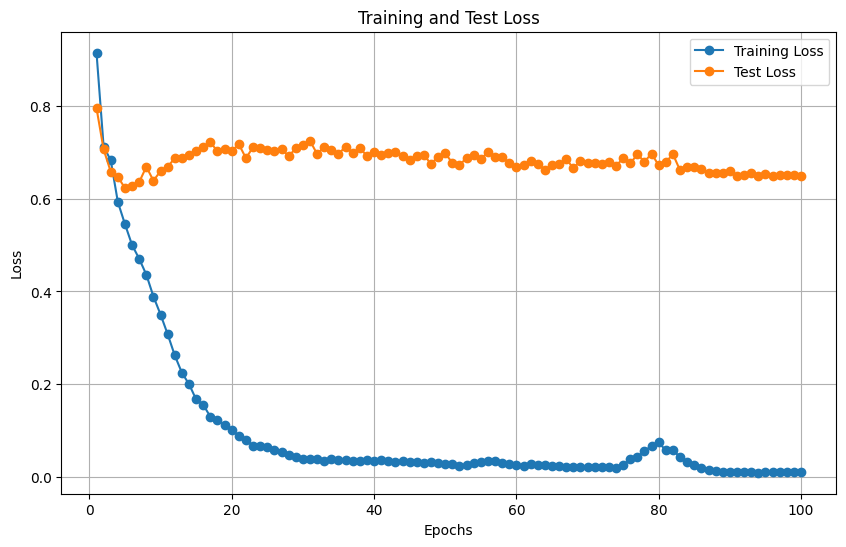

In [23]:
# Load loss values from JSON file
with open(LOSS_EPOCH_JSON_PATH, 'r') as file:
    loss_values = json.load(file)

# Graph the train/val loss plot
# Extract train and test loss values
train_losses = loss_values['train']
test_losses = loss_values['test']

# Create epochs array
epochs = range(1, len(train_losses) + 1)

# Plotting
plt.figure(figsize=(10,6))
plt.plot(epochs, train_losses, label='Training Loss', marker='o')
plt.plot(epochs, test_losses, label='Test Loss', marker='o')
plt.title('Training and Test Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.grid(True)
plt.show()

# Model Fine-Tuning Completed! Use for future inference!

# Choose best epoch!

**Use ./utils/checkpoint_evals to find the best epoch, after running the code blow, check the embeddings/cv_results/figure_results directory to find the produced graphs**

In [ ]:
# Use os.system() to run the .utils.checkpoint_evals.py script
os.system("python3 ./utils/checkpoint_evals.py")

***Select the checkpoint number that you want to load. For non-fine-tuned embeddings, just put 1. Then you could load epoch 58, which is what we used for this project. However, if you are using your own dataset, you will want to check the graphs produced to find out when performance declines***

In [35]:
#==============================DEFINING EPOCH CHECKPOINT NUMBER HERE==================================
CHECKPOINT_EPOCH_LOAD_NUMBER = 6 # 1 & 58 for hyenadna-tiny-1k-seqlen pretrained on Standard Datasets. You will load and run everything below for both 1 and 58.

**You can specify your own dataset paths, such as the train/test/val splits**

In [39]:
# For creating your own datapaths, use the following:
ds_load_path_list = [test_data_path, train_data_path, val_data_path]
PATH_TO_GENERATED_EMBEDDINGS = standard_ds_loader.path_to_generated_embeddings

In [40]:
run_datasets_hyena(ds_path_list=ds_load_path_list, embeddings_folder=PATH_TO_GENERATED_EMBEDDINGS)

Current dataset: ./data/train_val_test_splits/test.csv
Dataset path: ./data/train_val_test_splits/test.csv


Embeddings generated with shape: torch.Size([2612, 152, 128])
Saving embeddings to directory: ./data/ds_fine_tuned_embeddings
Saving embeddings to file path: ./data/ds_fine_tuned_embeddings/mmseqs_test_6.pth
Current dataset: ./data/train_val_test_splits/train.csv
Dataset path: ./data/train_val_test_splits/train.csv
Embeddings generated with shape: torch.Size([10447, 152, 128])
Saving embeddings to directory: ./data/ds_fine_tuned_embeddings
Saving embeddings to file path: ./data/ds_fine_tuned_embeddings/mmseqs_train_6.pth
Current dataset: ./data/train_val_test_splits/val.csv
Dataset path: ./data/train_val_test_splits/val.csv
Embeddings generated with shape: torch.Size([1314, 152, 128])
Saving embeddings to directory: ./data/ds_fine_tuned_embeddings
Saving embeddings to file path: ./data/ds_fine_tuned_embeddings/mmseqs_val_6.pth


# Now you can go to [2] and specify the embeddings path for analysis.